In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from scipy.signal import lfilter


In [2]:
con1 = pd.read_csv('../data/preprocessed/CSV/70B3D500700016DA.csv')
con2 = pd.read_csv('../data/preprocessed/good_csv/70B3D500700016DF.csv')

In [9]:
be = cleaning_del(con1)
be.shape

(7305, 5)

In [47]:
daily = be.groupby(pd.Grouper(key='time_stamp', axis=0, 
                        freq='1D', sort=True)).mean()

In [50]:
test_var = be.iloc[1, 0]

In [7]:
con3 = pd.read_csv('../data/preprocessed/good_csv/70B3D500700016DF.csv')

In [2]:
def cleaning(df):
    
    new = pd.DataFrame()
    new['device_id'] = df['deveui']
    new['time_stamp'] = pd.to_datetime(df['created_at'], format='%Y-%m-%d')    
    new['Height'] = df['Height'].str.replace('cm', '').astype(int)
    new['Temperature'] = df['Temperature'].str.replace('C', '').astype(int)
    new['Tilt'] = df['Tilt'].str.replace('Degree', '').astype(int)
    new.sort_values(by=['time_stamp'], ascending=True, inplace = True)

    return new


In [4]:
#selbe funktion wie oben - mit dem Unterschied, dass Einträge mit Messwerten die größer als 190 sind gelöscht werden

def cleaning_del(df):
    
    new = pd.DataFrame()
    #setting device id to join multiple bins later in the process
    new['device_id'] = df['deveui']
    #seeting time stamp
    new['time_stamp'] = pd.to_datetime(df['created_at'], format='%Y-%m-%d')    
    #deleting rows with values height > 190 -> Measurement errors
    new['Height'] = df['Height'].str.replace('cm', '').astype(int)
    new = new[new.Height < 190]
    
    #casting temperature to int and replace values > 100 with NaN
    new['Temperature'] = df['Temperature'].str.replace('C', '').astype(int)
    new.loc[(new.Temperature > 100), 'Temperature'] = np.nan
    #casting Tilt to int
    new['Tilt'] = df['Tilt'].str.replace('Degree', '').astype(int)
    #sorting values acording to time_stamp
    new.sort_values(by=['time_stamp'], ascending=True, inplace = True)

    return new

In [ ]:
#fill device id
#con2.device_id.fillna(method = 'bfill', inplace=True)
con2_group.device_id.fillna(method = 'bfill', inplace=True)
#fill na temp with mean
#replace tempature values above 100 Degrees with NaN
con2_group.loc[(con2_group.Temperature > 100), 'Temperature'] = np.nan

con2.Temperature.fillna(value = con2.Temperature.mean(), inplace = True)
con2_group.Temperature.fillna(value = con2_group.Temperature.mean(), inplace = True)
#fill na Tilt with mean
con2.Tilt.fillna(value = con2.Tilt.mean(), inplace = True)
con2_group.Tilt.fillna(value = con2_group.Tilt.mean(), inplace = True)

In [4]:
def smoothing_fillingNaN(df):
     
    #smooth with lfilter
    n = 60  # the larger n is, the smoother curve will be
    b = [1.0 / n] * n
    a = 1
    df['lfilter'] = lfilter(b,a, df['Height'])

    #moving average smoothing
    df['mov_avg'] = df['Height'].rolling(60).mean()

    #minimum moving average
    df['min_avg'] = df['Height'].rolling(60).min()

    
    #creating new DataFrame on Level Daily with aggregation max()
    daily = df.groupby(pd.Grouper(key='time_stamp', axis=0, 
                        freq='1D', sort=True)).mean()
    #add device_id
    daily['device_id'] = df.iloc[1, 0]

    #further smoothing on daily level with rolling mean window 2
    daily['mov_avg'] = daily['Height'].rolling(2).mean()

    #fill missing values with interpolation
    df['inter_pol'] = df['mov_avg'].interpolate(limit_direction = 'both')
    daily['inter_pol'] = daily['mov_avg'].interpolate(limit_direction = 'both')
    daily.inter_pol.fillna(method = 'backfill', inplace = True)

    #fill missing NaN in DeviceID
    daily['device_id'].fillna(method = 'bfill', inplace=True)

    #fill Temperature NaN with average
    daily.Temperature.fillna(value = df.Temperature.mean(), inplace = True)
    #fill Tilt NaNs with mean
    daily.Tilt.fillna(value = daily.Tilt.mean(), inplace = True)

    return df, daily

Plots mit Funktion cleaning() in der die Messwerte größer 190 *nicht* gelöscht werden

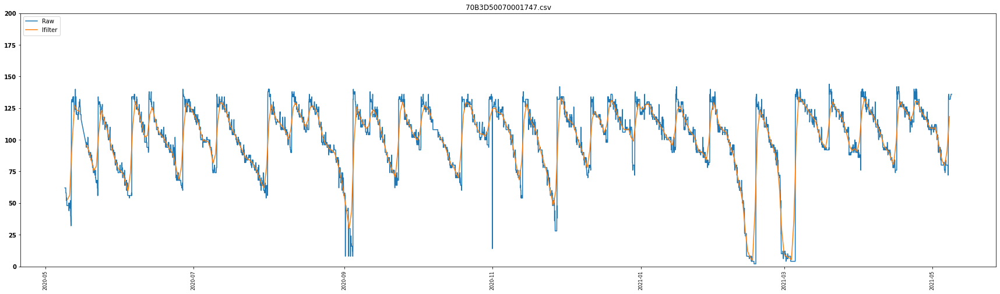

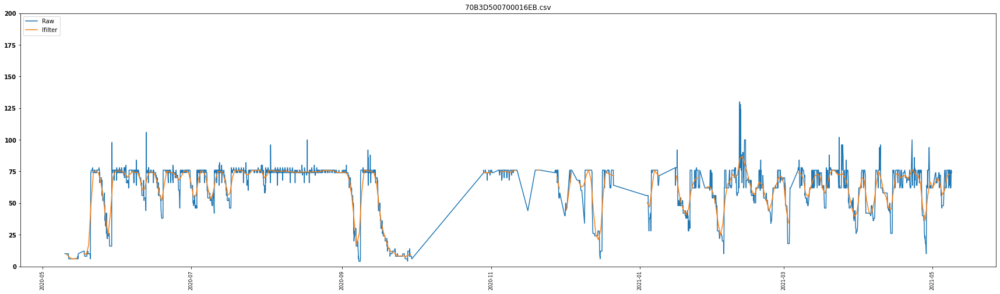

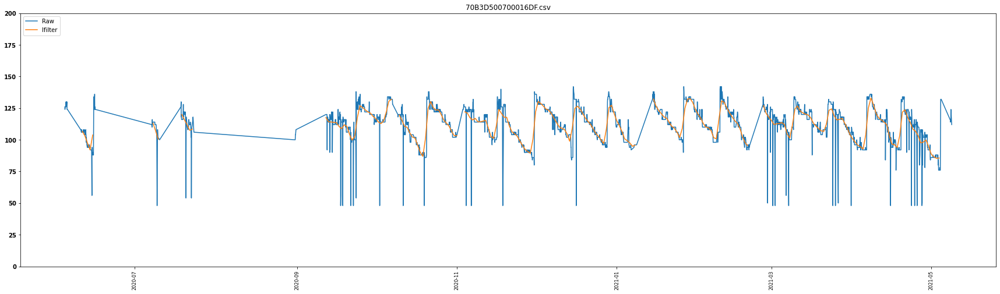

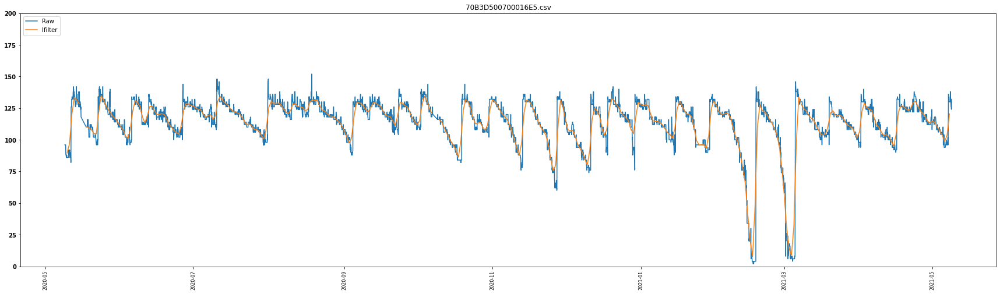

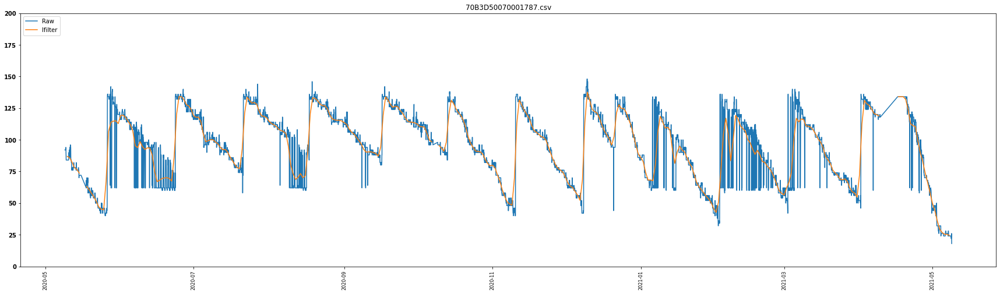

...

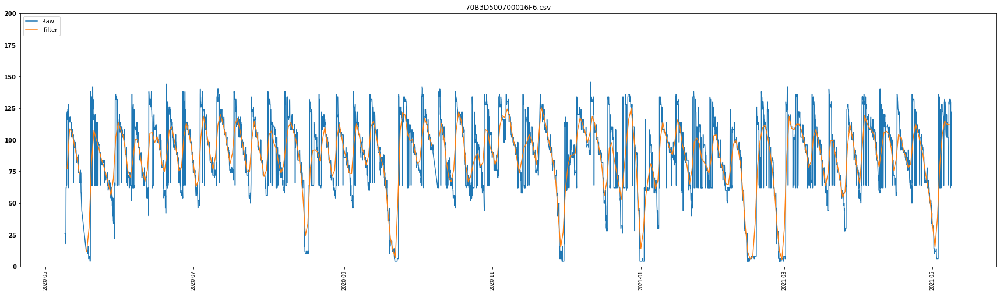

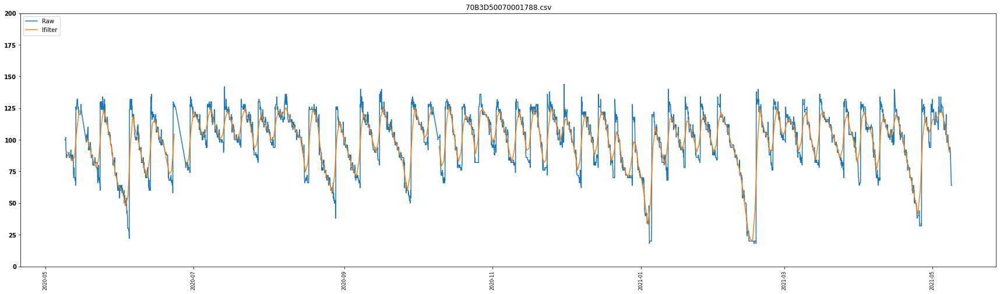

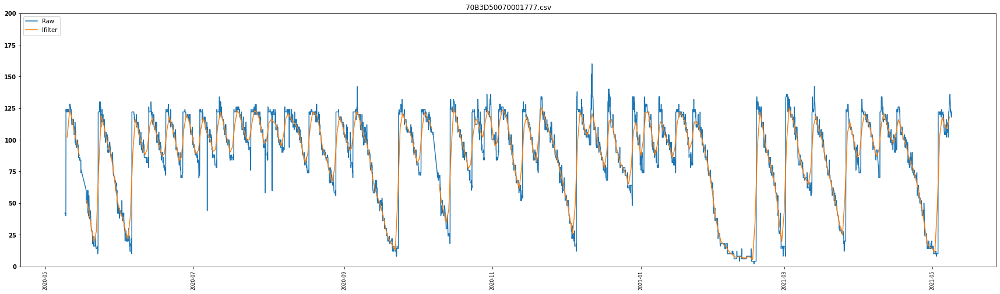

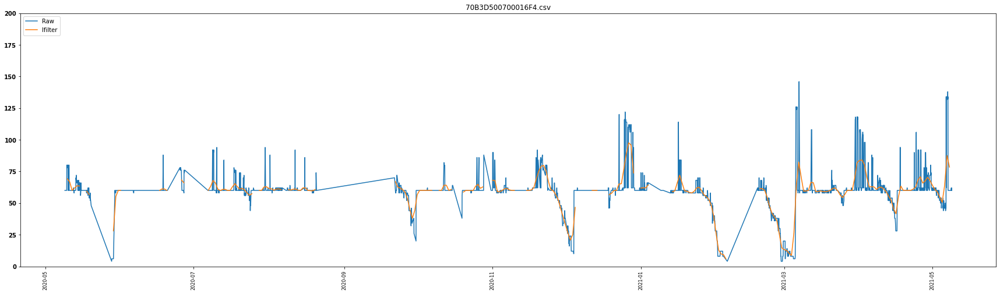

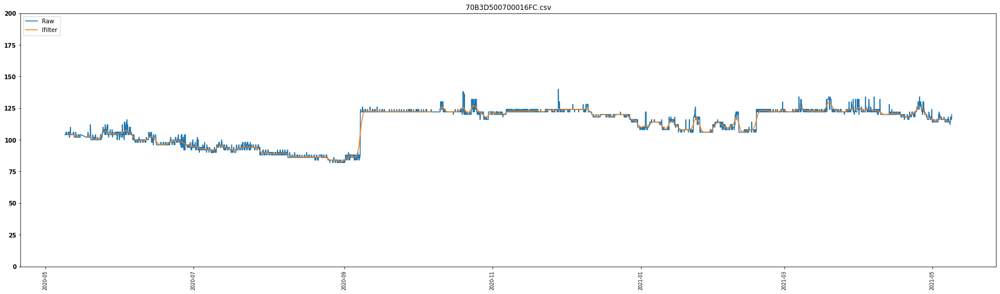

In [52]:
csv_folder = '../data/preprocessed/good_csv/'
csv_files = [csv for csv in os.listdir(csv_folder) if csv.endswith('.csv')]

for file in csv_files:
    # import DataFrame
    df = pd.read_csv('../data/preprocessed/CSV/' + file)
    
    df = cleaning_del(df)
    df, grouped = smoothing_fillingNaN(df)

    plt.figure(figsize=(30,8))
    plt.ylim((0,200))
    plt.title(file)

    plt.xticks(fontsize=8, rotation=90)
    plt.yticks(fontsize=10, fontweight='bold')
    plt.plot(df['time_stamp'], df['Height'])

    #plt.plot(test['time_stamp'], test['lfilter'])
    #plt.plot(test['time_stamp'], test['mov_avg'])
    #plt.plot(test['time_stamp'], test['min_avg'])
    #plt.plot(daily['Height'])
    plt.plot(grouped['mov_avg'])


    plt.legend(['Raw', 'lfilter', 'mov_avg', 'min_avg', 'grouped'], loc='upper left')

    plt.show()



alle Plots mit gelöschten Messwerten größer als 190

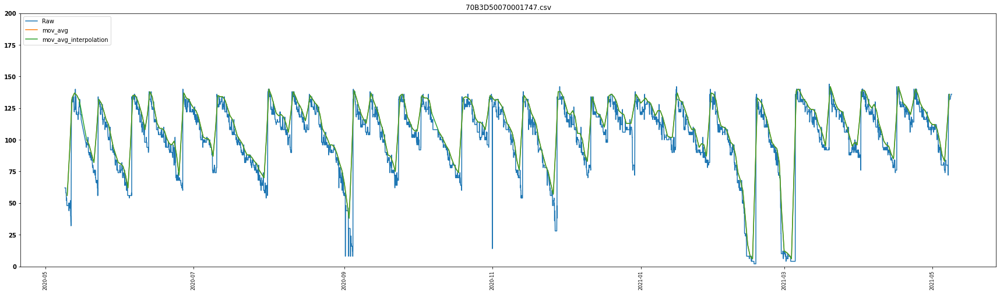

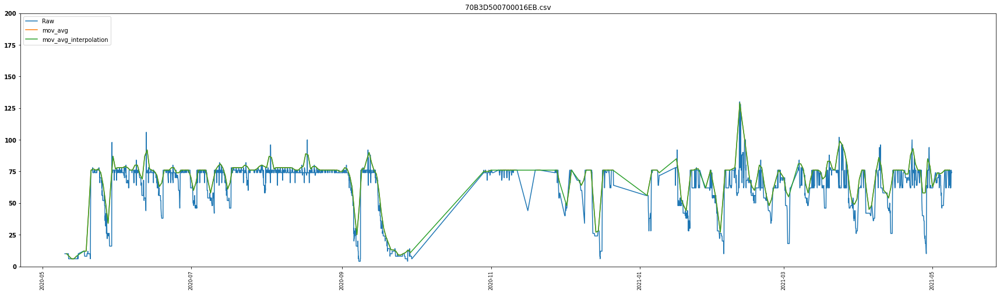

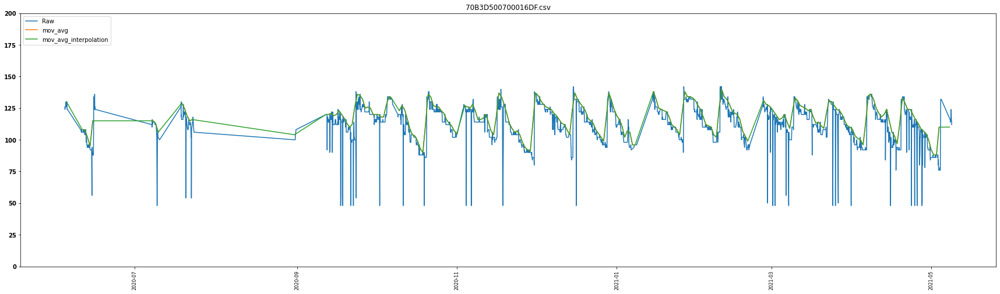

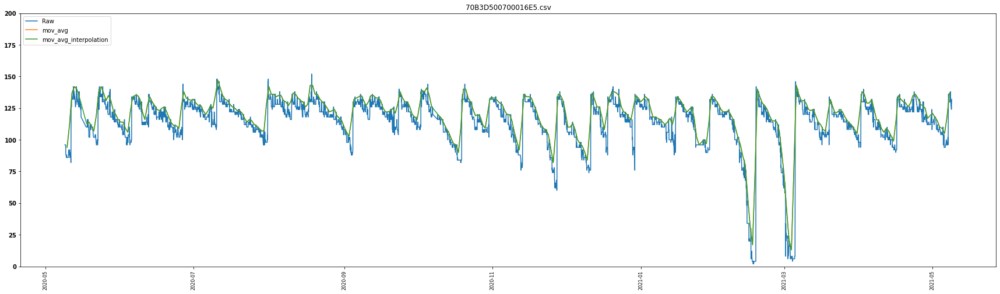

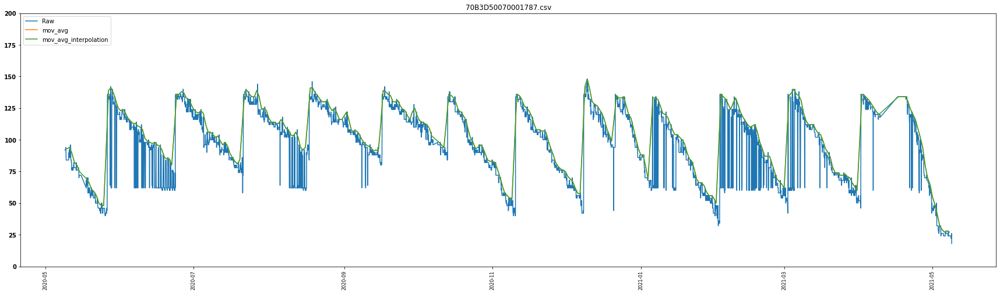

...

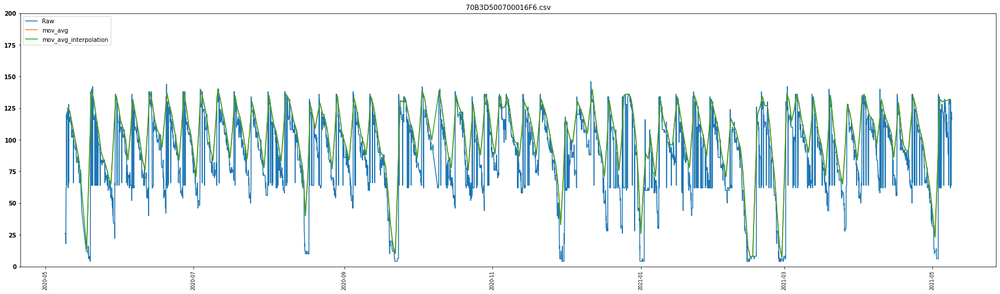

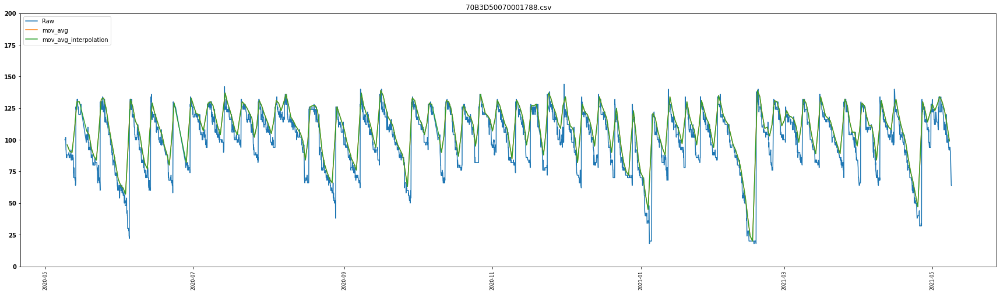

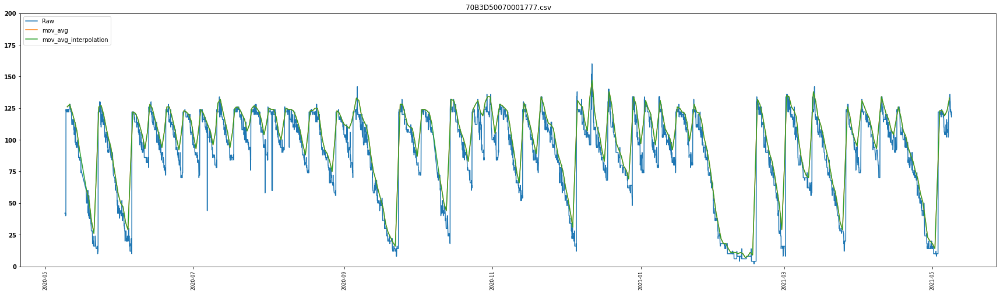

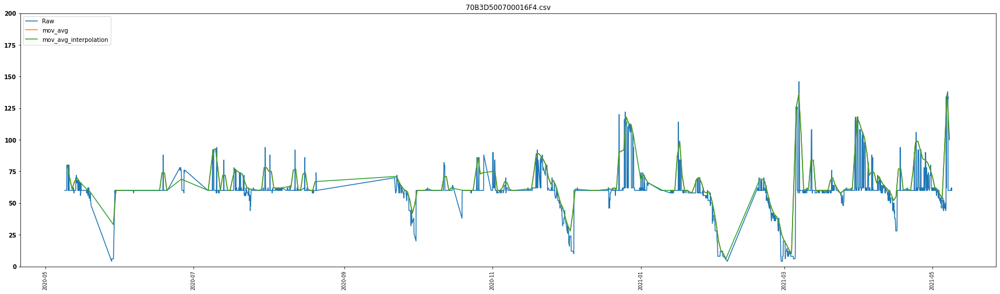

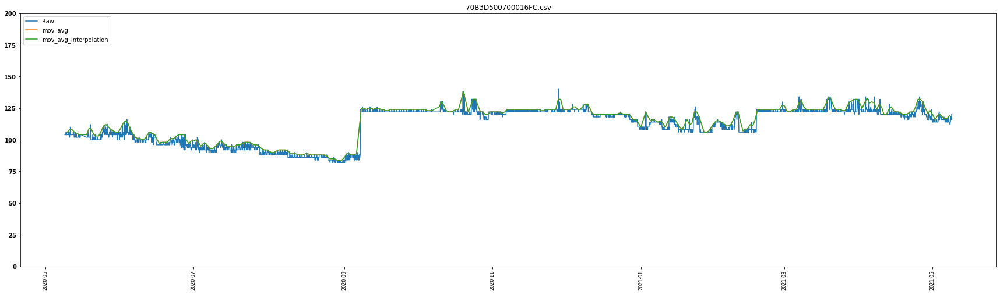

In [53]:
csv_folder = '../data/preprocessed/good_csv/'
csv_files = [csv for csv in os.listdir(csv_folder) if csv.endswith('.csv')]

for file in csv_files:
    # import DataFrame
    df = pd.read_csv('../data/preprocessed/CSV/' + file)
    
    df = cleaning_del(df)
    df, grouped = smoothing(df)

    plt.figure(figsize=(30,8))
    plt.ylim((0,200))
    plt.title(file)

    plt.xticks(fontsize=8, rotation=90)
    plt.yticks(fontsize=10, fontweight='bold')
    plt.plot(df['time_stamp'], df['Height'])

    #plt.plot(test['time_stamp'], test['lfilter'])
    #plt.plot(test['time_stamp'], test['mov_avg'])
    #plt.plot(test['time_stamp'], test['min_avg'])
    #plt.plot(daily['Height'])
    plt.plot(grouped['mov_avg'])
    plt.plot(grouped['inter_pol'])


    plt.legend(['Raw', 'mov_avg', 'mov_avg_interpolation', 'min_avg', 'grouped'], loc='upper left')

    plt.show()

# Calculating/Clustering different bins based on their simialarity

In [9]:
#reading in all bins and performing pre-processing

csv_folder = '../data/preprocessed/good_csv/'
csv_files = [csv for csv in os.listdir(csv_folder) if csv.endswith('.csv')]
count = 1
all_series = pd.DataFrame()
#df_list = list()

for file in csv_files:
    #print(file)
    
    # import DataFrame
    df = pd.read_csv('../data/preprocessed/good_csv/' + file)
    
    df = cleaning_del(df)
    df, grouped = smoothing_fillingNaN(df)

    #write the interpolated hight into columns
    all_series[file] = grouped['inter_pol']
    count = count + 1

In [10]:
#transform dataframe to numpy array

from tslearn.utils import to_time_series_dataset

time_series = to_time_series_dataset(all_series)

/Users/davidblumenthal/opt/miniconda3/envs/bda/lib/python3.9/site-packages/tslearn/bases/bases.py:15: UserWarning: h5py not installed, hdf5 features will not be supported.
Install h5py to use hdf5 features: http://docs.h5py.org/
  warn(h5py_msg)


In [49]:
 #roate array into correct shape
 a = np.rot90(time_series, k = 3)
 a.shape

(42, 365, 1)

In [106]:
#turn into float
time_series = time_series.astype(float)

In [33]:
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

In [50]:
#scale values
train = TimeSeriesScalerMeanVariance().fit_transform(a)
#initialise cluster algorithm
dba_km = TimeSeriesKMeans(n_clusters = 3,  metric = "dtw", max_iter = 50)
#predict clusters and save
pred = dba_km.fit_predict(train)

In [47]:
sz = train.shape[1]

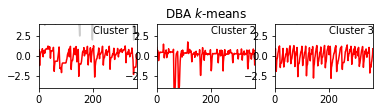

In [51]:
#print sample of the different clusters
for yi in range(3):
    plt.subplot(3, 3, 4 + yi)
    for xx in a[pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=.2)
    plt.plot(dba_km.cluster_centers_[yi].ravel(), "r-")
    plt.xlim(0, sz)
    plt.ylim(-4, 4)
    plt.text(0.55, 0.85,'Cluster %d' % (yi + 1),
             transform=plt.gca().transAxes)
    if yi == 1:
        plt.title("DBA $k$-means")

In [55]:
#transform numpy predictions to list
clust_list = pred.tolist()

In [57]:
#create dict with bin name and its corresponding cluster
csv_folder = '../data/preprocessed/good_csv/'
csv_files = [csv for csv in os.listdir(csv_folder) if csv.endswith('.csv')]
clusters = dict()
#df_list = list()

for file, clust in zip(csv_files, clust_list):
    clusters.update( {file : clust})


In [58]:
print(clusters)

{'70B3D50070001747.csv': 1, '70B3D500700016EB.csv': 0, '70B3D500700016DF.csv': 2, '70B3D500700016E5.csv': 1, '70B3D50070001787.csv': 0, '70B3D50070001750.csv': 0, '70B3D500700016E7.csv': 0, '70B3D50070001786.csv': 1, '70B3D500700016EE.csv': 0, '70B3D500700016DA.csv': 0, '70B3D5007000174F.csv': 0, '70B3D50070001781.csv': 0, '70B3D50070001742.csv': 0, '70B3D500700016E0.csv': 0, '70B3D5007000175A.csv': 0, '70B3D50070001724.csv': 2, '70B3D50070001730.csv': 2, '70B3D5007000172C.csv': 0, '70B3D50070001725.csv': 2, '70B3D5007000173E.csv': 2, '70B3D50070001726.csv': 0, '70B3D50070001737.csv': 2, '70B3D5007000173C.csv': 0, '70B3D50070001709.csv': 2, '70B3D50070001734.csv': 0, '70B3D50070001739.csv': 2, '70B3D50070001738.csv': 0, '70B3D50070001710.csv': 2, '70B3D50070001704.csv': 0, '70B3D50070001706.csv': 0, '70B3D5007000171A.csv': 0, '70B3D50070001716.csv': 0, '70B3D50070001700.csv': 0, '70B3D50070001772.csv': 2, '70B3D500700016F1.csv': 0, '70B3D50070001770.csv': 0, '70B3D500700016FA.csv': 2, 

In [62]:
#write dictionary to json file
import json
jsonString = json.dumps(clusters)
jsonFile = open('series_cluster.json', "w")
jsonFile.write(jsonString)
jsonFile.close()